In [1]:
# Data Manipulation and Preprocessing
import numpy as np
import pandas as pd
import json
import labtools

# Data Visualization
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud
import plotly.graph_objects as go
import plotly.express as px
from plotnine import *

# TF-IDF and Dimensionality Reduction
from sklearn.decomposition import TruncatedSVD
from sklearn.feature_extraction.text import TfidfVectorizer

# Clustering
from scipy.cluster.hierarchy import dendrogram, linkage
from scipy.cluster.hierarchy import fcluster

# Warnings
import warnings
# Suppress the SettingWithCopyWarning
warnings.filterwarnings('ignore')

# Web Interaction and Display
from IPython.display import Image, display, HTML

# Additional JavaScript for toggling code display in Jupyter Notebooks
HTML(
    """
<script src="https://cdnjs.cloudflare.com/ajax/libs/jquery/2.0.3/jquery.min.js "></script>
<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.jp-CodeCell > div.jp-Cell-inputWrapper').hide();
 } else {
 $('div.jp-CodeCell > div.jp-Cell-inputWrapper').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<form action="javascript:code_toggle()"><input type="submit"
    value="Click here to toggle on/off the raw code."></form>
"""
)

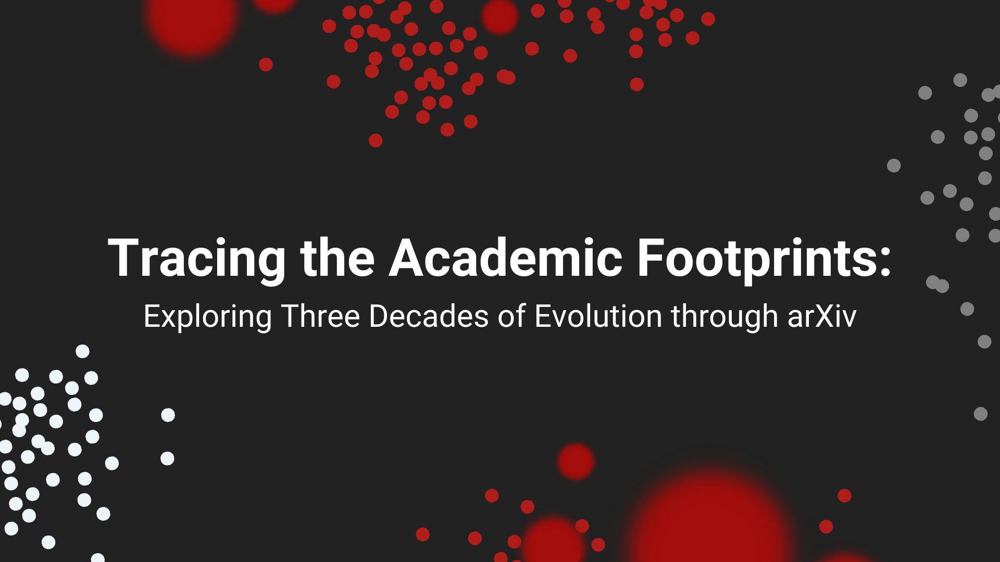

<div style="background-color:#711012; padding: 10px 0;">
    <center><h1 style="color: white; font-weight:bold">ABSTRACT</h1></center>
</div>


This study delves into the evolving landscape of academic research themes over the past three decades, drawing insights from the arXiv preprint repository spanning from 1995 to 2024. By leveraging unsupervised clustering techniques, we were able to analyze thematic rajectories across diverse disciplines, including mathematics, physics, computer science, and statistics. The clustering analysis unveiled patterns of thematic convergence, divergence, and interdisciplinary interaction, providing nuanced perspectives on the dynamics of knowledge evolution. Moreover, we were able to identify persistent themes and observe subtle variations in research emphasis in every timeframe, which improves our understanding of subtle variations and transformations within the realm of research.

<div style="background-color:#711012; padding: 10px 0;">
    <center><h1 style="color: white; font-weight:bold">INTRODUCTION</h1></center>
</div>


<div style="background-color: #cbc6c6; padding: 10px 0;">
    <center><h2 style="color: #242424;font-weight:bold">Background</h2></center>
</div>

Academic research continuously evolves over time as new discoveries emerge and research frontiers expand in different directions. Tracing the thematic trajectories of research and identifying the genesis and decline of topics can provide important insights into the underlying dynamics of knowledge evolution. This study aims to analyze the evolution of research themes and areas from publications spanning 30 years on the arXiv preprint repository.

arXiv hosts a massive collection of academic publications across domains like physics, mathematics, computer science, quantitative biology, quantitative finance, and statistics. Leveraging this corpus covering three decades of cutting-edge research provides a unique opportunity to investigate temporal shifts in scholarly focus. However, the scale and variety of publications pose significant challenges for systematic topic analysis. Unsupervised clustering techniques provide a robust solution by detecting latent patterns in the document collection and identifying clusters of publications centered around coherent themes.

In this work, we conduct a temporal analysis by clustering arXiv abstracts into thematic groups for each year from 1995 to 2024. Comparing cluster compositions and keyword distributions over time can reveal the emergence of new research directions and changing prominence of established areas. Furthermore, tracking cluster lineage and continuity enables studying splitting, merging, or fading of topics. Thus, clustering presents a data-driven framework to quantify evolving research landscapes without relying on predefined taxonomies. The outcomes can help understand trends in disciplines and sub-fields represented in arXiv as well as identify cross-disciplinary interactions between nascent and mature topics. Overall, this methodology and large-scale dataset provides an opportunity to unlocked novel, granular insights into the dynamics of science.

<div style="background-color: #cbc6c6; padding: 10px 0;">
    <center><h2 style="color: #242424;font-weight:bold">Problem Statement</h2></center>
</div>

**How can we leverage today's technology and arXiv's vast research repository to gain granular insights into the evolution of research themes over the past 30 years?** 

In particular:
- How do specialized sub-domains split from larger fields or converge into new intersections over long periods?
- What specific research areas gained or lost prominence over time spans of multiple decades?

<div style="background-color: #cbc6c6; padding: 10px 0;">
    <center><h2 style="color: #242424;font-weight:bold">Objectives</h2></center>
</div>

With the advent of technological breakthroughs and as the field of data science continues to grow, there is an increasing need to understand how academic research evolves and adapts to these changes over time. In particular, exploring the thematic trajectories of research can provide valuable insights into the dynamics of knowledge creation and dissemination across different tenets of data science. 

Thus, the objectives of this study are as follows:
1. **Analysis of Thematic Evolutions.** Identify and analyze the thematic trajectories of research areas across different disciplines represented in the arXiv repository from 1995 to 2024.
2. **Identify Specialized Sub-domains**. Explore the emergence of specialized sub-domains within larger fields and examine how they evolve over time, including the dynamics of splitting and merging.
3. **Analysis of Interdisciplinary Collaboration**. Determine if there are cross-disciplinary interactions and the emergence of new intersections between research topics, especially in areas that greatly influence the field of data science.

<div style="background-color:#711012; padding: 10px 0;">
    <center><h1 style="color: white; font-weight:bold">DATA SOURCES AND DESCRIPTION</h1></center>
</div>


arXiv hosts a massive collection of academic publications across domains like physics, mathematics, computer science, quantitative biology, quantitative finance, and statistics. Leveraging this corpus covering three decades of cutting-edge research provides a unique opportunity to investigate temporal shifts in scholarly focus.

The original dataset is ~1.1 TB (at the time of posting on [Kaggle](https://www.kaggle.com/datasets/Cornell-University/arxiv/), but only ~2.4 million articles were utilized to manage computational complexity. The `json` file contains the following information for each paper:

Variable | Description
--- | ---
`id` | ArXiv ID (can be used to access the paper, see below)
`submitter` | Who submitted the paper
`authors` | Authors of the paper
`title` | Title of the paper
`comments` | Additional info, such as number of pages and figures
`journal-ref` | Information about the journal the paper was published in
`doi` | [Digital Object Identifier](https://www.doi.org)
`abstract` | The abstract of the paper
`categories` | Categories / tags in the ArXiv system
`versions` | A version history

<center>
    <h6>
        <b>Table 1. 
        </b> arXiv Dataset Variables
    </h6>
</center>


<div style="background-color:#711012; padding: 10px 0;">
    <center><h1 style="color: white; font-weight:bold">METHODOLOGY</h1></center>
</div>


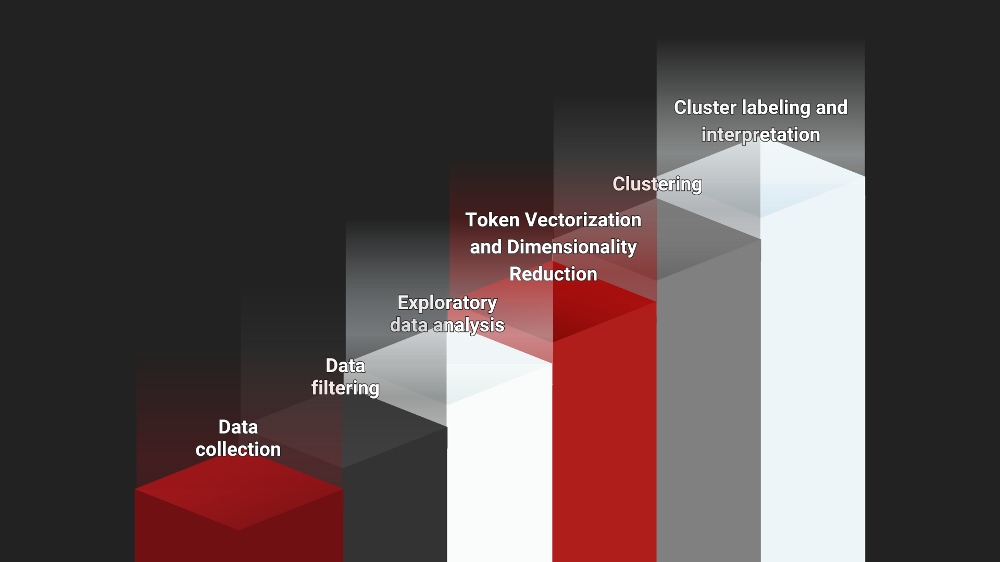

<center><b>Figure 1.</b> Methodology Pipeline</center>

**1. Data Collection**

Gathering of arXiv data from Jojie, which is also made available on [Kaggle](https://www.kaggle.com/datasets/Cornell-University/arxiv/). Note that a preprocessed data was created and used thereafter for the implementation of clustering. The details of data preprocessing are contained in a supplementary notebook named `Data_Extraction`.

**2. Data Filtering**

To reduce the complexity of the dataset, we restricted our analysis to the years between 1995 and 2024, using a 5-year interval. Additionally, we specifically selected categories within Computer Science, Mathematics, and Statistics. These three categories are fundamental to data science, as depicted in Drew Conway's Diagram of Data Science (Figure 1). Note that the actual filtering of the dataset was done on a separate notebook to maintain the conciseness of the main report.

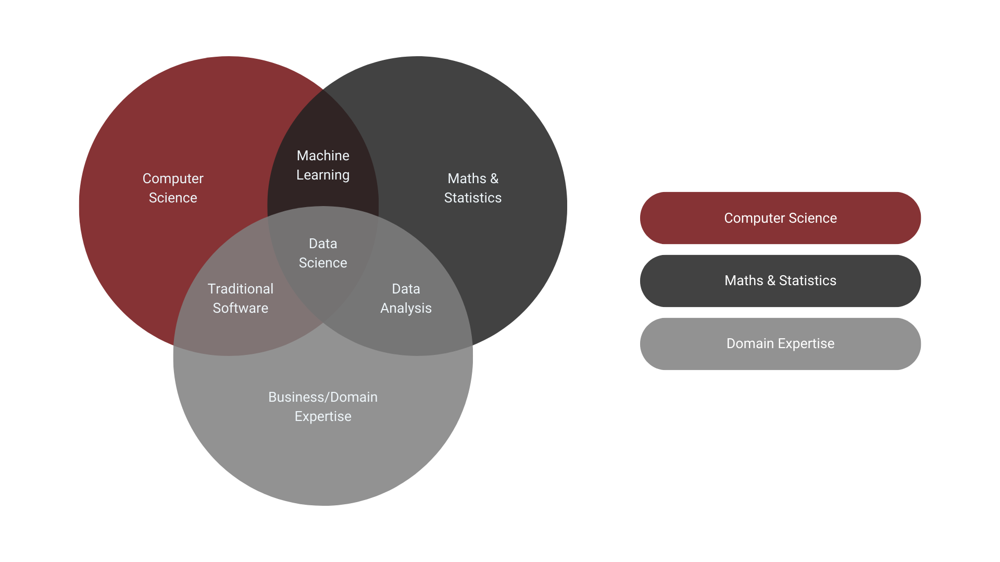
<center><b>Figure 2.</b>Drew Conway's Diagram of Data Science</center>

**3. Exploratory Data Analysis**: Do an initial exploration of the data to identify interesting trends.

**4. Token Vectorization**: Convert the abstract of each paper into numerical vectors, where each token (word) in the text is represented by a unique numerical value. This was done using TF-IDF (Term Frequency-Inverse Document Frequency). The optimal parameters of TF-IDf were determined using a sparsity plot.

**5. Dimensionality Reduction using SVD**: Identify the optimal number of components to retain at least 90% variance explained then implement SVD

**6. Clustering**: Implement agglomerative clustering using Ward's method as the linkage method for all 5-year intervals starting in 1995, then assign each paper on the clustering. Note that for some years, an additional subclustering was done to organize the articles into more meaningful groups.

<div style="background-color:#711012; padding: 10px 0;">
    <center><h1 style="color: white; font-weight:bold">EXPLORATORY DATA ANALYSIS</h1></center>
</div>


To know more about the data, the team performed an exploratory data analysis centered on answering the following:
1. What is the trend of research publications from 1995 to 2024?
2. Which category dominates the research space over the years?

From an initial analysis, we see that the number of research publications have been increasing exponentially for the past thirty years. This could be attributed to several factors, including advancements in technology, the increasing accessibility of research resources and tools, globalization of research networks, and the growing emphasis on academic productivity and collaboration. Additionally, the rise of interdisciplinary research and the proliferation of online publishing platforms like arXiv have also contributed to the surge in research publications.

In [28]:
final_df = pd.read_csv('dmw2-others/lab/final_df.csv')

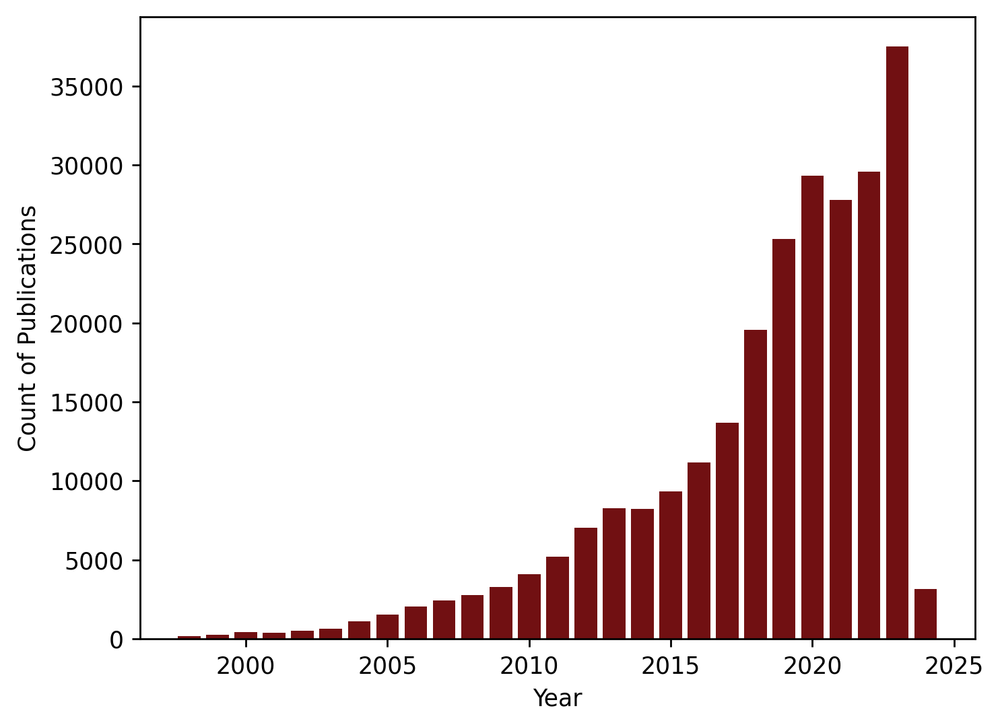

In [34]:
year_counts = final_df.year.value_counts().reset_index()
year_counts = year_counts[year_counts['count'] >= 100]
year_counts.columns = ['year', 'count']
plt.figure(dpi=250)
plt.bar(year_counts['year'], year_counts['count'], color='#711012')
plt.xlabel('Year')
plt.ylabel('Count of Publications')
plt.show()

<center><b>Figure 3.</b> Trend of Research Publications on arXiv from 1995 to 2024</center>

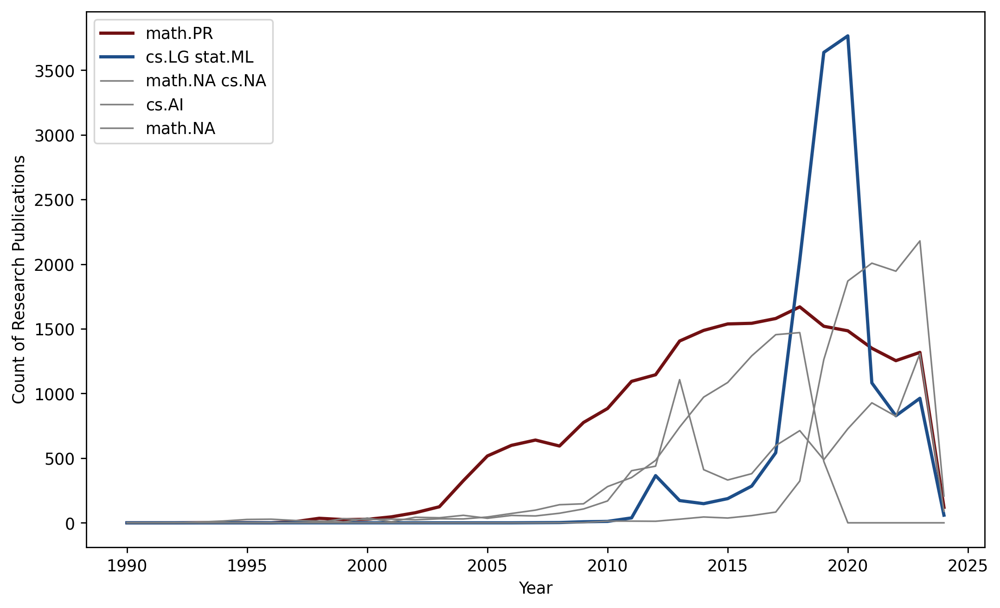

In [47]:
pivot_df = final_df.pivot_table(index='categories', columns='year', 
                                aggfunc='size', fill_value=0)

top_categories = (pivot_df.sum(axis=1).sort_values(ascending=False)
                  .head(5)
                  .index)

top_cat_df = pivot_df.loc[top_categories]

plt.figure(figsize=(10, 6), dpi=250)
colors = ['#711012', '#1d4e89'] + ['grey'] * (len(top_categories) - 2)
for category, color in zip(top_cat_df.index, colors):
    plt.plot(top_cat_df.columns, top_cat_df.loc[category], label=category, 
             color=color, linewidth=2 if color in ['#711012', '#1d4e89'] 
             else 1)
plt.xlabel('Year')
plt.ylabel('Count of Research Publications')
plt.legend()
plt.xticks()
plt.show()

<center><b>Figure 4.</b> Dynamics of Sub-Categories Across Time (1995-2024)</center>

Among the sub-categories we have chosen for the study, the top 5 sub-categories (Figure 3) show that it is mostly dominated by studies from the mathematics sub-categories/field of study, with math.PR leading at 20,000, suggesting strong, consistent interest due to the large amount of research being conducted in this field. In contrast, the "cs.LG stat.ML" category, which includes machine learning, shows a dramatic spike in interest around 2020, potentially reflecting a surge in machine learning applications and research within this period. This suggests that while foundational mathematics remains a constant in the field, interest in applied areas such as machine learning can vary greatly, possibly influenced by technological advancements and industry demands.

<div style="background-color:#711012; padding: 10px 0;">
    <center><h1 style="color: white; font-weight:bold">CLUSTERING</h1></center>
</div>

An **agglomerative clustering** method was utilized to study how research themes have evolved from 1995 to 2024. The hierarchical tree of clusters produced by this method is crucial in analyzing cluster merges and splits over time. While the number of clusters could be inferred from the number of categories chosen, the deeper insights come from understanding granular clusters that were formed under these categories——the dendrogram is very helpful to visualize these thematic evolutions. Among the different linkage criteria in agglomerative clustering, the Ward's method stands out as particularly suitable for this case where the data exhibits heteroscedasticity. Ward's method addresses this by minimizing the within-cluster variance when merging clusters at each step of the algorithm, which leads to intuitive interpretations.

Moreover, we implemented Ward’s Method of clustering in two ways. The first approach involved applying the method to all the years between 1995 and 2024, with 250 and 500 samples from each year. The second method applied clustering to every five-year interval, such as cluster 1995-2000, then cluster 2001-2005, and so forth.

The purpose of employing the *get-all-cluster-all* technique was to gauge the most popular research themes over the past thirty years. This approach helps us identify which topics appear saturated in terms of the number of publications produced about them and potential emerging areas of interest, those with fewer publications as of writing.

However, it is important to note that this method does not imply that a popular research topic is present throughout 1995 to 2024. Rather, it suggests that among the research themes identifiable through the abstract and title, certain ones seem to be the most interesting to researchers.

To determine the most salient topics at a more granular level, that is, every year, we implemented clustering on a five-year interval starting in 1995 until 2024. Indeed, as you will see later, there are themes in one timeframe that are not necessarily present in the other. This technique provides us with greater insights into how the realm of research evolved over the span of thirty years.

In this main notebook, we illustrate one instance of clustering for the years 2011 to 2015. The implementation details of the *get-all-cluster-all* technique, as well as the implementation of clustering on the other timeframes, are contained in separate notebooks. The summary of the resulting topics can be found at the bottom of this report.

In [2]:
final_df = pd.read_csv('final_df.csv')

# For removing the stopwords later
# Open the stopwords file
with open('stopwords_dmw.txt', 'r') as file:
    # Read the contents of the file
    stopwords_content = file.read()

# Split the contents into individual stopwords
stopwords_list = stopwords_content.split('\n')

# Optionally, remove any empty strings from the list
stopwords_list = [word for word in stopwords_list if word.strip()]

<div style="background-color: #cbc6c6; padding: 10px 0;">
    <center><h4 style="color: #242424;font-weight:bold">Token Vectorization</h4></center>
</div>

This is a snippet of a list of consolidated abstracts of two publications submitted between 2011 and 2015.

In [3]:
# Get the 2011-2015 data
window = list(range(2011, 2016))
df_2011 = final_df[final_df.year.isin(window)]
df_2011 = labtools.get_sample(df_2011, window, sample_size=1000)

# Get the abstract of the 1995 dataset
abs_2011 = df_2011.abstract.to_list()
print(abs_2011[:2])

['  Let H(t,x) be the Hopf-Cole solution at time t of the Kardar-Parisi-Zhang\n(KPZ) equation starting with narrow wedge initial condition, i.e. the logarithm\nof the solution of the multiplicative stochastic heat equation starting from a\nDirac delta. Also let H^{eq}(t,x) be the solution at time t of the KPZ equation\nwith the same noise, but with initial condition given by a standard two-sided\nBrownian motion, so that H^{eq}(t,x)-H^{eq}(0,x) is itself distributed as a\nstandard two-sided Brownian motion. We provide a simple proof of the following\nfact: for fixed t, H(t,x)-(H(t,x)-H^{eq}(t,0)) is locally of finite variation.\nUsing the same ideas we also show that if the KPZ equation is started with a\ntwo-sided Brownian motion plus a Lipschitz function then the solution stays in\nthis class for all time.\n', "  We consider the Bernoulli bond percolation process $\\mathbb{P}_{p,p'}$ on the\nnearest-neighbor edges of $\\mathbb{Z}^d$, which are open independently with\nprobability $p<

We next create a matrix representing certain words on this list as a column and their corresponding frequencies within each abstract as values in the matrix. This matrix allows for quantitative analysis of the abstracts based on the occurrence of specific keywords or terms. 

To determine the optimal values for `min_df` and `max_df`, we created a heatmap that shows the sparsity of the TF-IDF matrix for different combinations of `min_df` and `max_df` values. The sparsity is calculated as the ratio of zero elements in the matrix to the total number of elements.

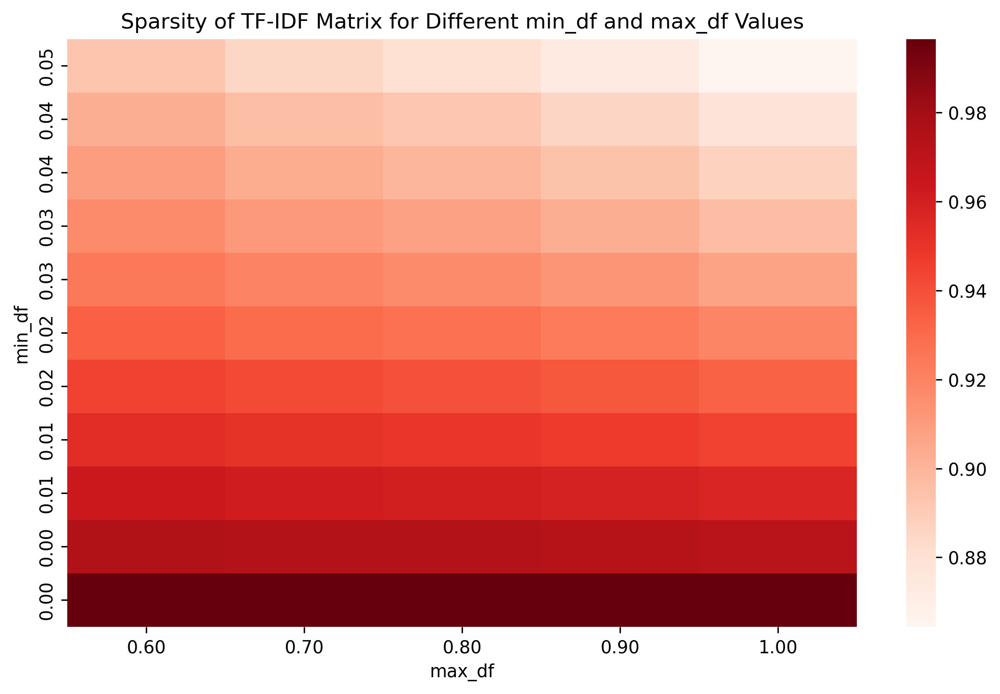

In [4]:
# Visualize the sparsity of the abstracts
labtools.visualize_sparsity(abs_2011)

<center>
    <h6>
        <b>Figure 5. 
        </b> Sparsity of TF-IDF Matrix for Different <code>min_df</code> and<code>max_df</code> values
    </h6>
</center>

The balance between the sparsity and vocabulary size appears to be with `min_df = 0.03` and `max_df = 0.80`. Let's vectorize the abstracts in these years accordingly.

In [6]:
# Vectorize the 2011-2015 dataset
df_tfidf_11 = labtools.vectorize_abstract(abs_2011, min_df=0.03, max_df=0.80)
df_tfidf_11.head(3)

,accuracy,accurate,adaptive,addition,algorithms,approximate,approximation,approximations,art,article,...,transition,tree,underlying,uniform,uniformly,unknown,upper,values,variance,weak
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.000000,0.0,0.0,0.00000,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.000000,0.032545,0.0,0.0,0.02785,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.280199,0.000000,0.0,0.0,0.00000,0.0,0.0


Number of components for at least 90% variance explained: 197


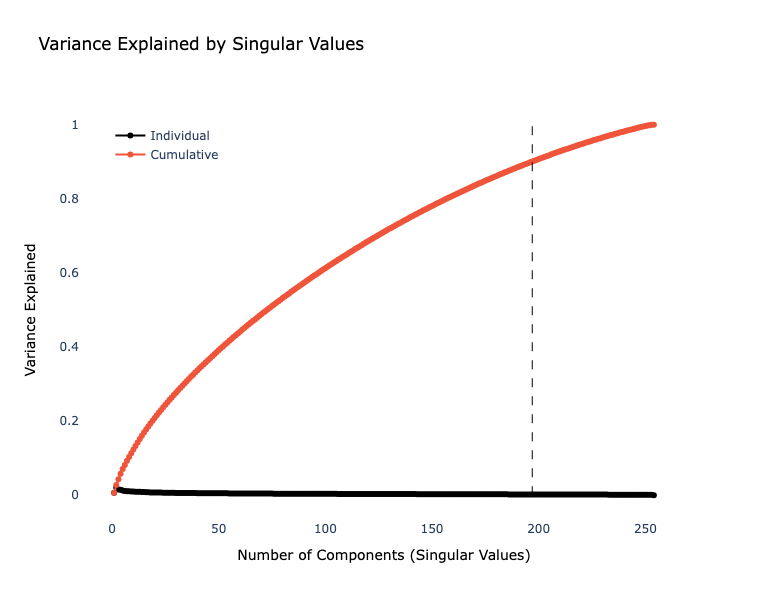

197

In [7]:
labtools.get_n_components(df_tfidf_11, show_viz=True)

<center>
    <h6>
        <b>Figure 6. 
        </b> Individual and Cumulative Variance Explained of the SV Components
    </h6>
</center>


Reduce the number of dimensions of our dataset based on the initial check.

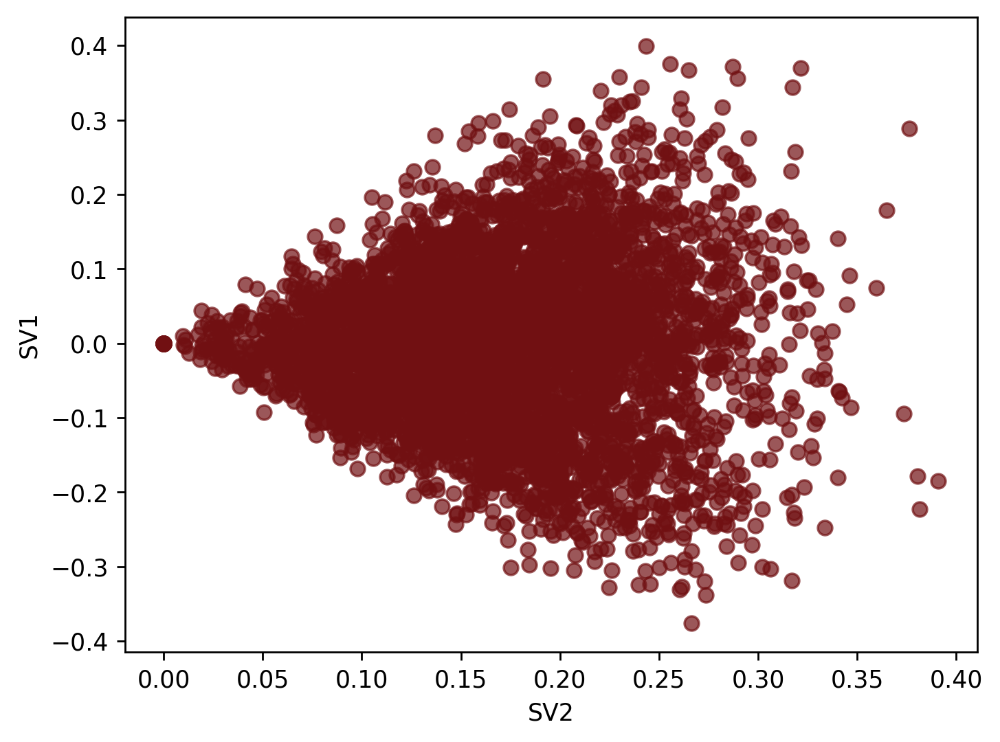

In [9]:
reduced_11 = labtools.reduce_dimensions(labtools.get_n_components(df_tfidf_11, 
                                                         show_viz=False),
                                        df_tfidf_11)
plt.figure(dpi=250)
plt.scatter(reduced_11[:, 0], reduced_11[:, 1], alpha=0.7, color='#711012')
plt.xlabel('SV2')
plt.ylabel('SV1');

<center>
    <h6>
        <b>Figure 7. 
        </b> The TF-IDF as projected to the first two singular vectors
    </h6>
</center>


From the plot of the points, we can see that the scatter of the data points widens or narrows as we move along a singular vector. This suggests that the spread or dispersion of the data is not constant throughout the dataset, i.e., the dataset is heteroscedastic. Thus, the Ward's Method is an approriate agglomerative clustering to use.

<div style="background-color: #cbc6c6; padding: 10px 0;">
    <center><h4 style="color: #242424;font-weight:bold">Clustering</h4></center>
</div>

Optimal number of clusters: 2
Threshold distance: 6.217339


6.217338556128039

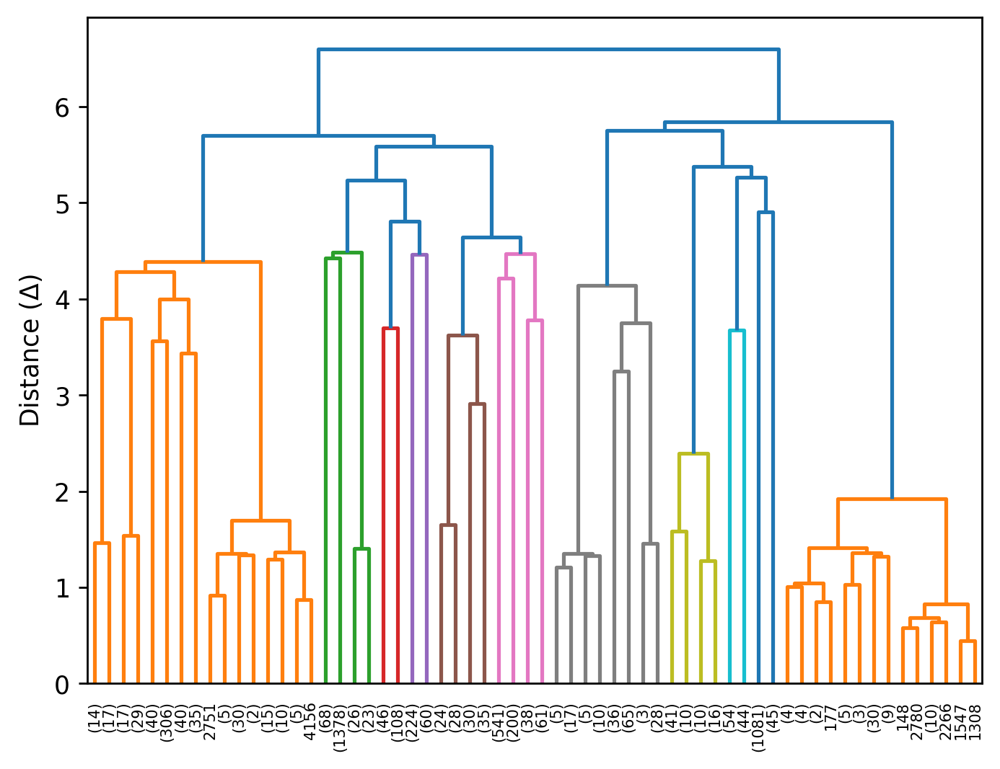

In [10]:
labtools.hierarchical_clustering(reduced_11)

<center>
    <h6>
        <b>Figure 8. 
        </b> Ward's Clustering Dendrogram Results
    </h6>
</center>


#### **EDA on Main Clusters**
Let's first check the two main clusters. This is what it looks when projected on the first two singular vectors:

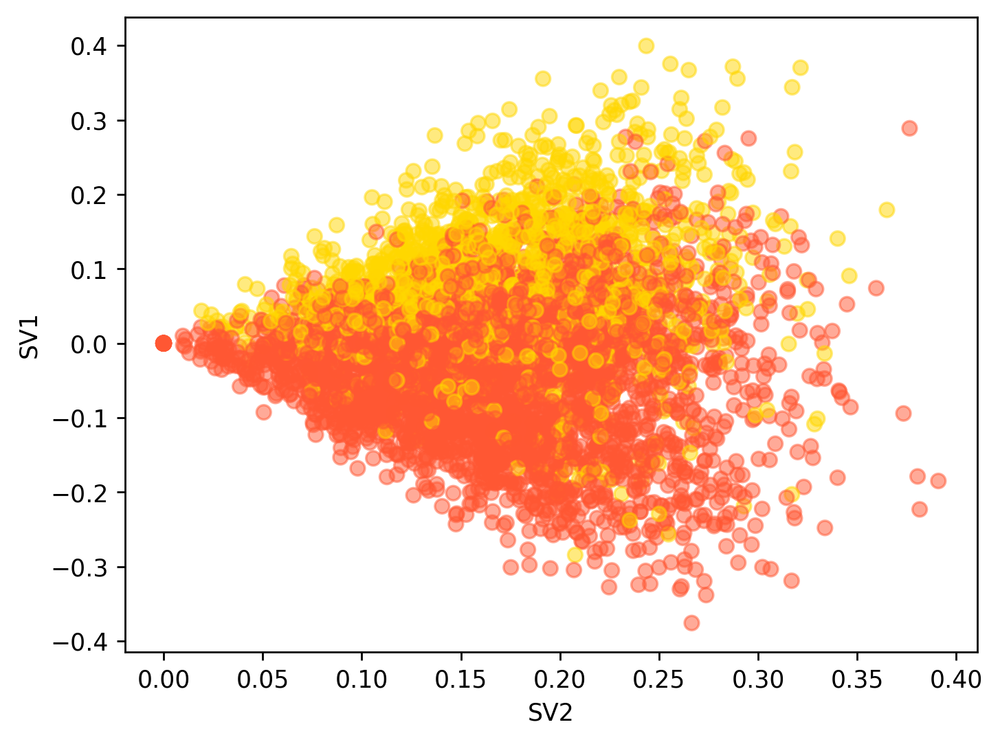

In [11]:
labtools.cluster_predict(reduced_11, df_2011, show_viz=True)

<center>
    <h6>
        <b>Figure 9. 
        </b> Clustering Results as Projected on the First Two Singular Vectors
    </h6>
</center>

Let's visualize the abstracts of the publications belonging to each main cluster using a word cloud to have an idea on what the cluster is all about.

In [12]:
clustered_df = labtools.cluster_predict(reduced_11, df_2011, 
                                        show_viz=False,
                                        get_updated_df=True)

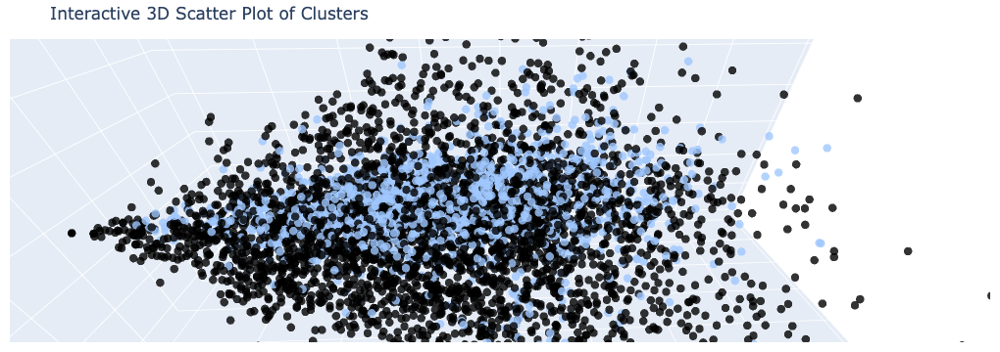

In [13]:
# Create a 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=reduced_11[:, 0],
    y=reduced_11[:, 1],
    z=reduced_11[:, 2],
    mode='markers',
    marker=dict(
        size=5,
        color=clustered_df['cluster'],  # Color points based on cluster
        colorscale='blackbody',  # Choose a color scale
        opacity=0.8
    ),
    text=clustered_df['cluster'].astype(str)  # Add cluster labels as text
)])

# Set axis labels
fig.update_layout(scene=dict(
    xaxis_title='SV 1',
    yaxis_title='SV 2',
    zaxis_title='SV 3',
    aspectratio=dict(x=2, y=1, z=1)  # Adjust the aspect ratio as needed
))

# Adjust the layout to fill the entire space while keeping the controls visible
fig.update_layout(
    autosize=True,  # Enable autosizing to keep controls visible
    margin=dict(l=10, r=10, t=40, b=10),  # Adjust margin values for control visibility
)

# Add title to the plot
fig.update_layout(title='Interactive 3D Scatter Plot of Clusters')

# Show the plot
fig.show()


<center>
    <h6>
        <b>Figure 10. 
        </b> Initial Clustering Results as Projected on the First Two Singular Vectors (3D)
    </h6>
</center>

#### **Initial Cluster 1: 2011-2015**

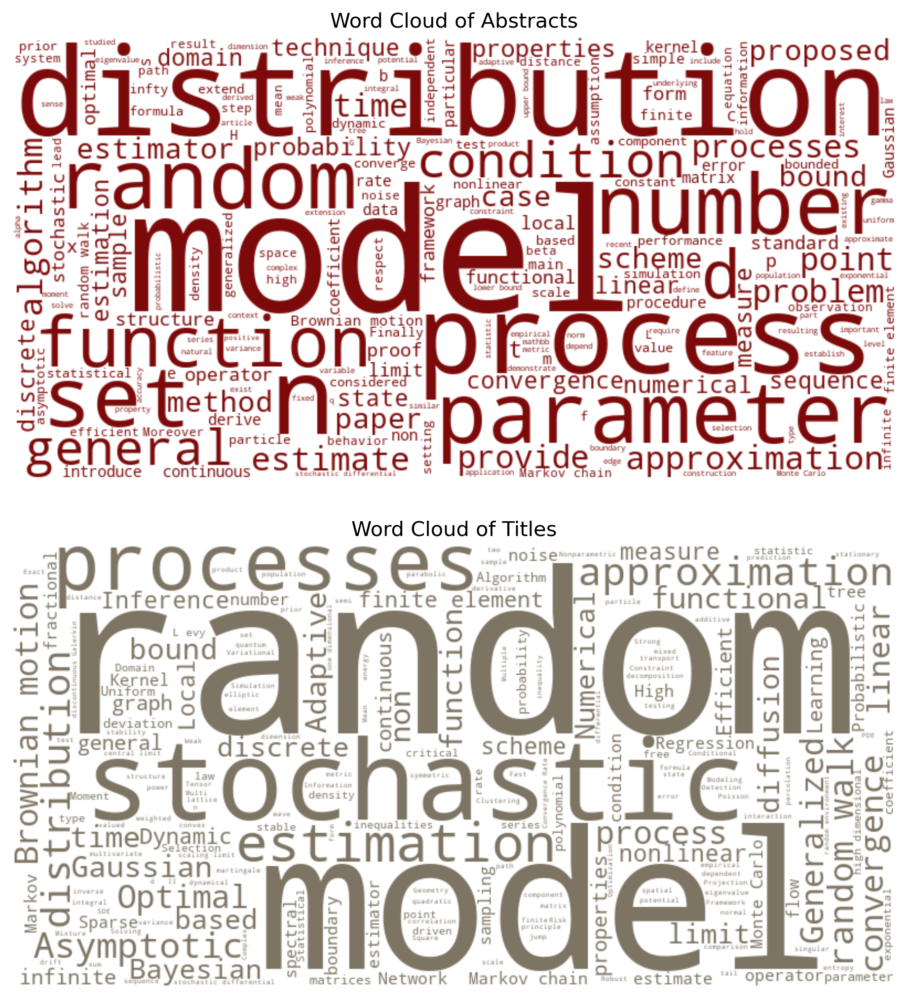

In [14]:
labtools.generate_wordclouds(clustered_df, cluster_number=1)

<center>
    <h6>
        <b>Figure 11. 
        </b> Word Cloud of Initial Cluster 1
    </h6>
</center>

#### **Initial Cluster 2: 2011-2015**

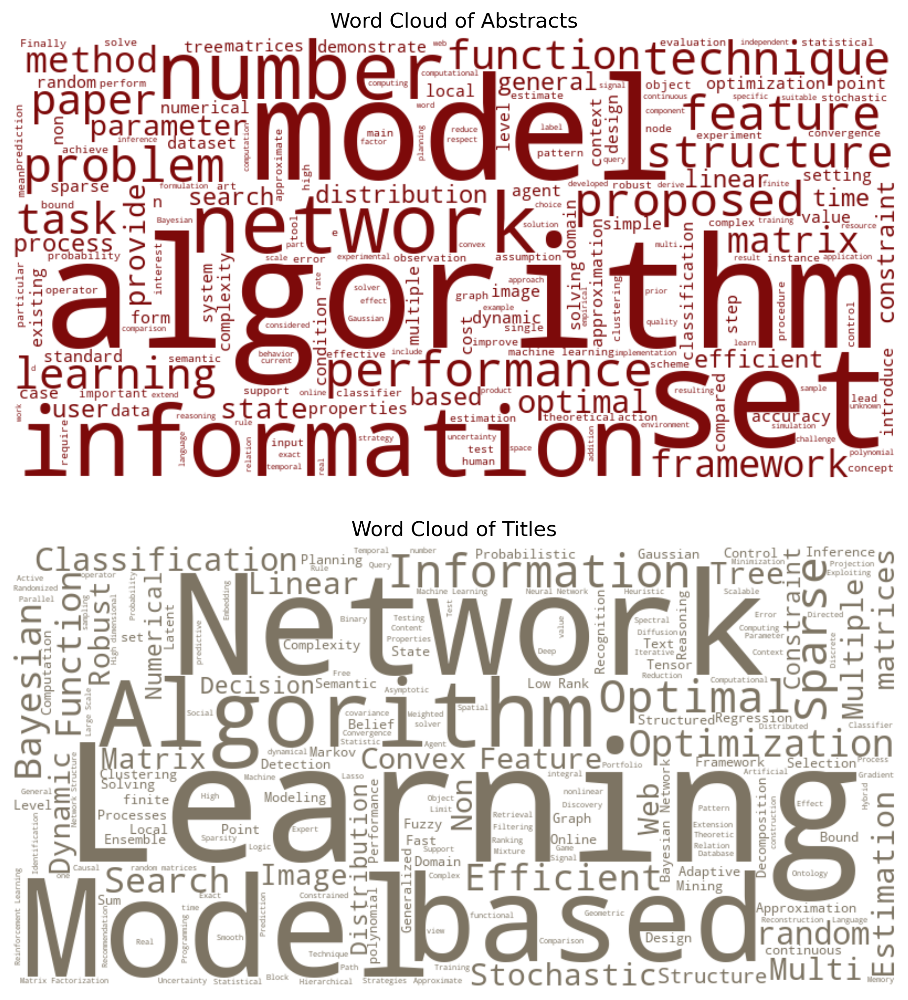

In [15]:
labtools.generate_wordclouds(clustered_df, cluster_number=2)

<center>
    <h6>
        <b>Figure 12. 
        </b> Word Cloud of Initial Cluster 2
    </h6>
</center>

**How imbalanced are our main clusters between 2011 and 2015?**

From the plot below, Cluster 1 has significantly more points than Cluster 2. Because of this, it could be worth investigating its sub-clusters. 

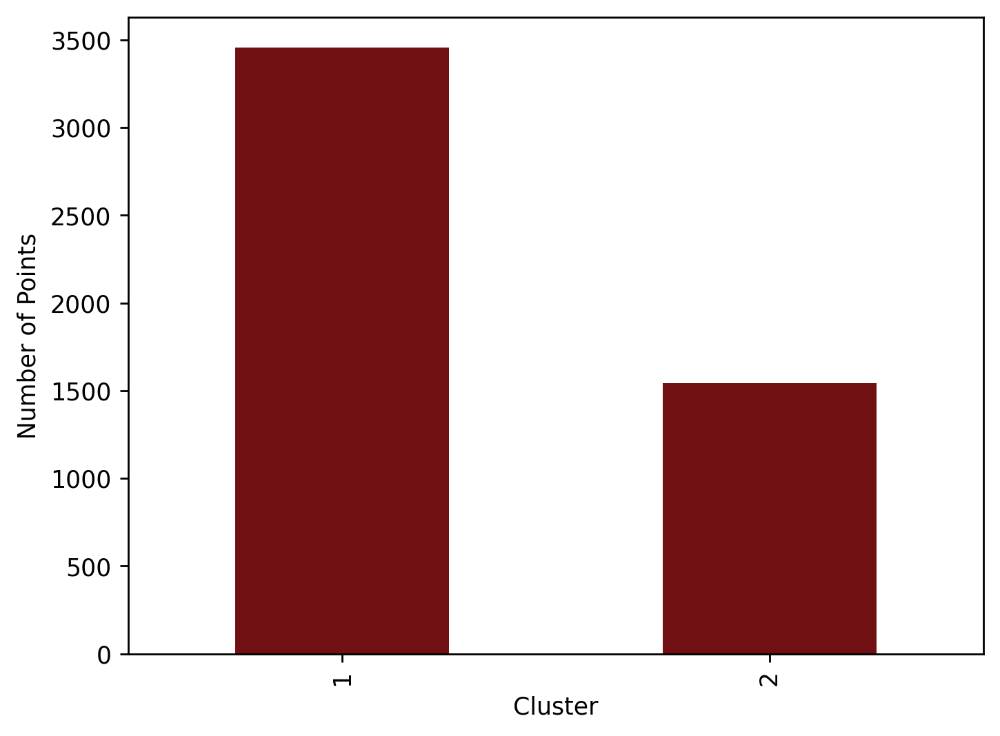

In [16]:
plt.figure(dpi=250)
clustered_df.cluster.value_counts().plot(kind='bar', color='#711012',
                                         xlabel='Cluster',
                                         ylabel='Number of Points');

<center>
    <h6>
        <b>Figure 13. 
        </b> Visualizing the Distribution of Points to the Initial Clusters
    </h6>
</center>

To do this, we refer back to our dendrogram and change our threshold so that we would capture the subclusters of the large main cluster. Through eyeballing it, a threshold of 5.8 would suffice. The resulting distribution looks like this:

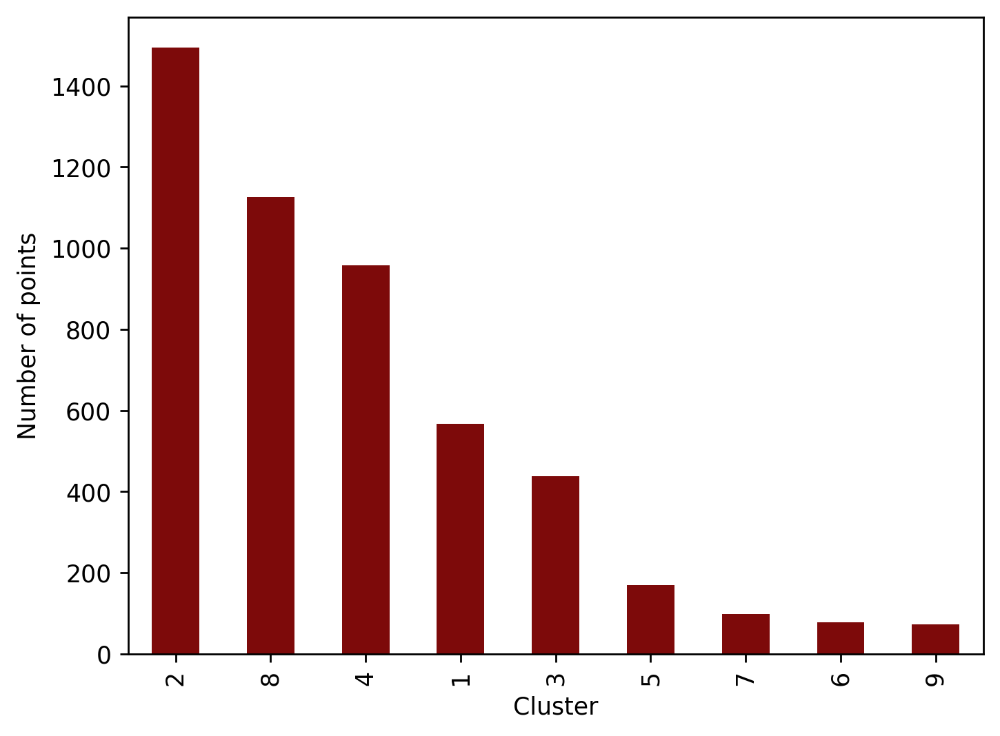

In [17]:
clustered_df = labtools.cluster_predict(reduced_11, df_2011, show_viz=False, 
                               get_updated_df=True, thres=5)

plt.figure(dpi=250)
clustered_df.cluster.value_counts().plot(kind='bar', color='#7d0a0a', 
                                         xlabel='Cluster',
                                         ylabel='Number of points');

<center>
    <h6>
        <b>Figure 14. 
        </b> Visualizing the Distribution of Points after Re-clustering 
    </h6>
</center>

Although several clusters still dominate the others with respect to the number of points, the general distribution of the points improved. Let's see what words compose each of these clusters.

#### **Final Cluster 1 (2011-2015)**

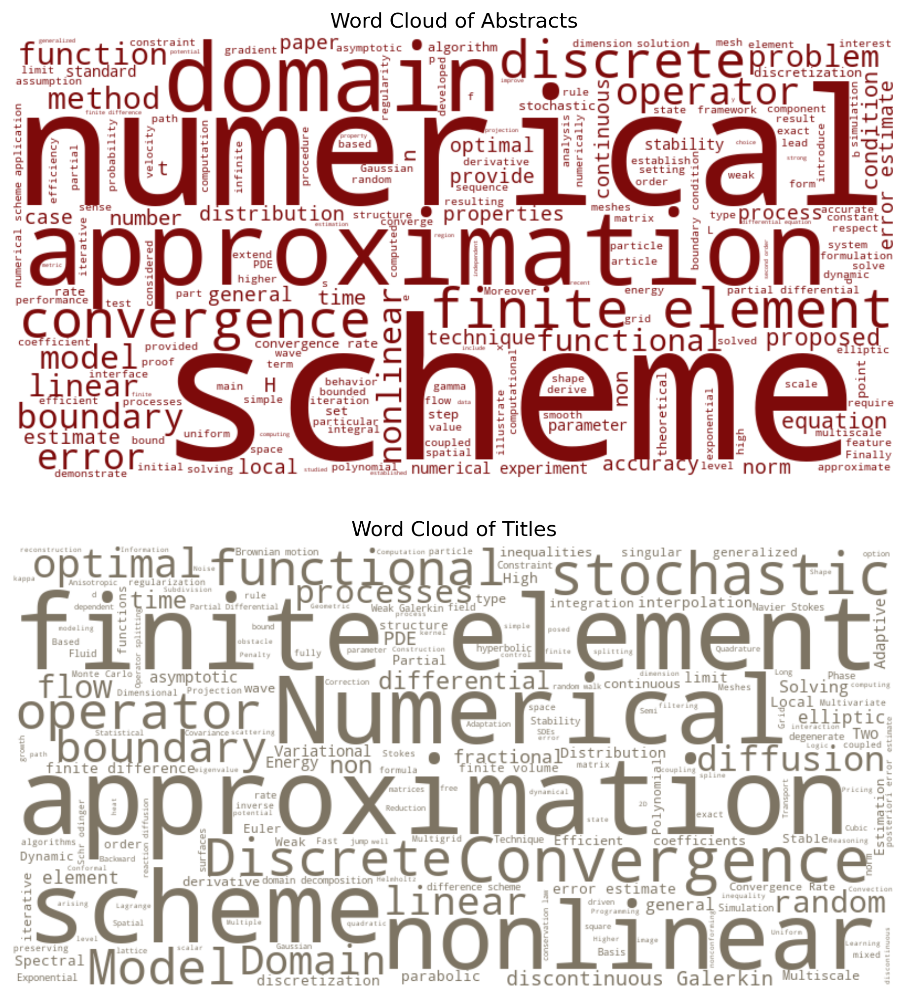

In [18]:
# Cluster 1: (2011-2015)
labtools.generate_wordclouds(clustered_df, cluster_number=1)

<center>
    <h6>
        <b>Figure 15. 
        </b> Word Cloud of Final Cluster 1 (2011-2015)
    </h6>
</center>

#### **Final Cluster 2 (2011-2015)**

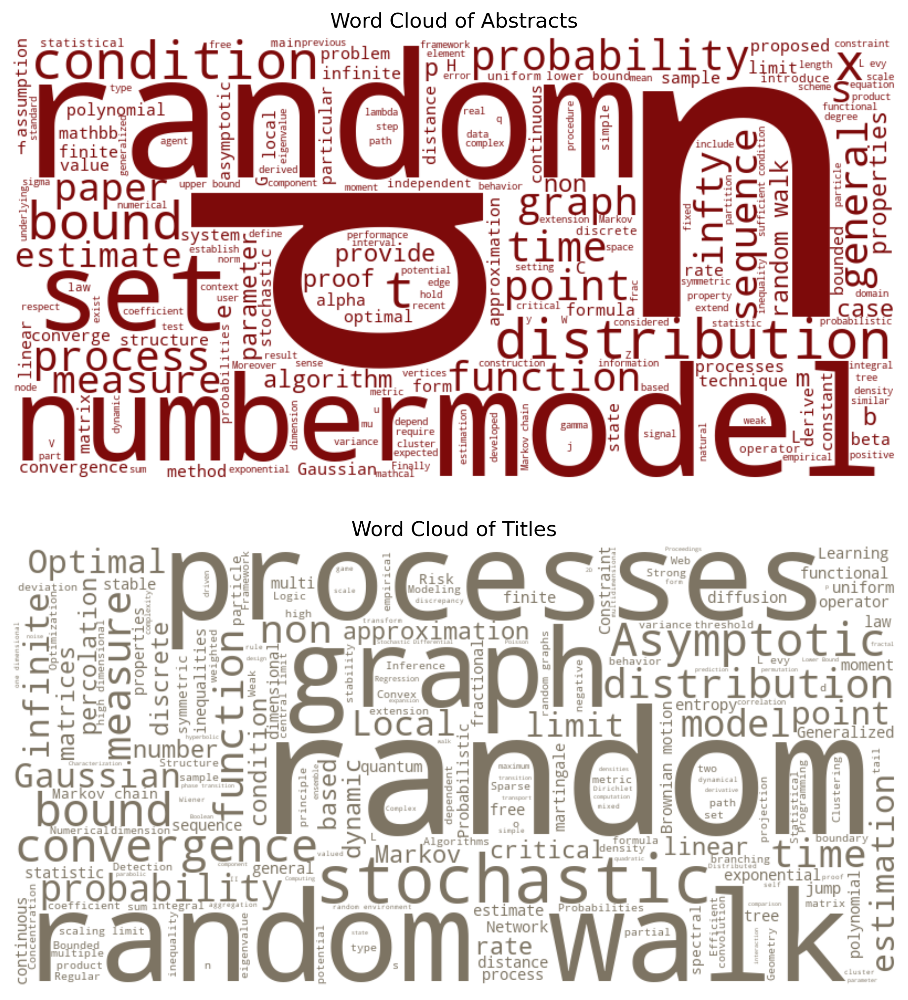

In [19]:
# Cluster 2: (2011-2015)
labtools.generate_wordclouds(clustered_df, cluster_number=2)

<center>
    <h6>
        <b>Figure 16. 
        </b> Word Cloud of Final Cluster 2 (2011-2015)
    </h6>
</center>

#### **Final Cluster 3 (2011-2015)**

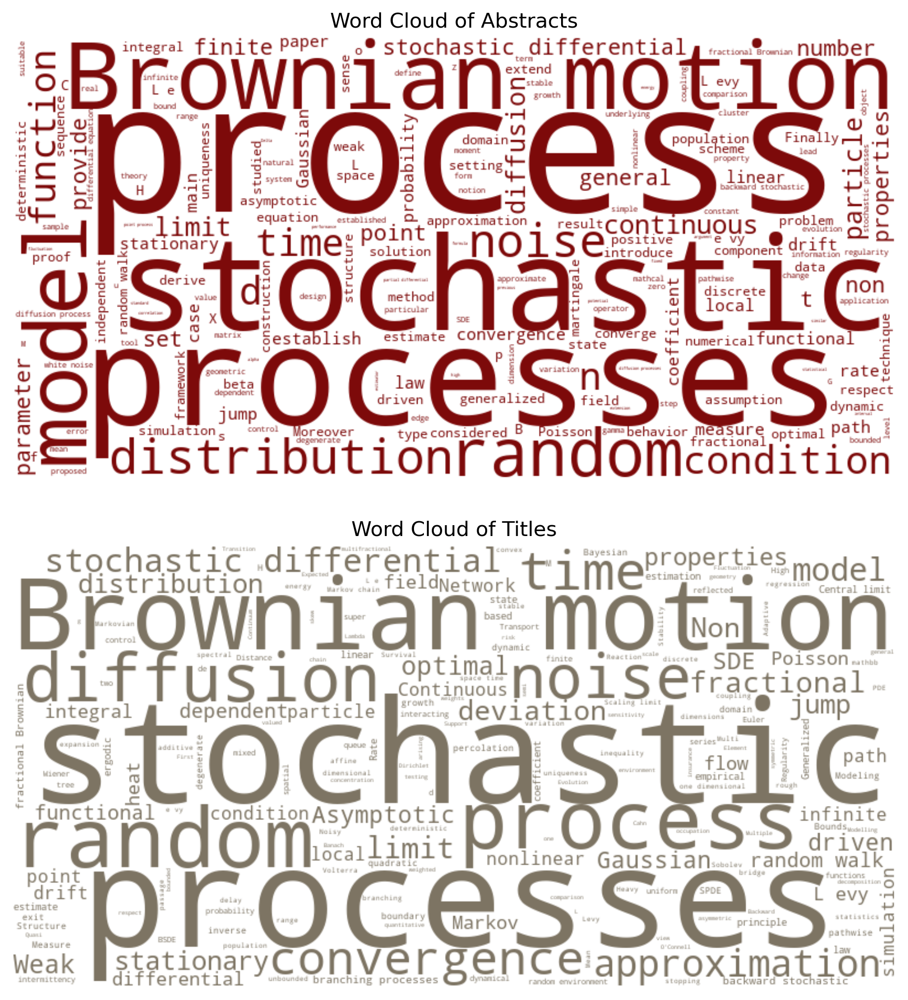

In [20]:
# Cluster 3: (2011-2015)
labtools.generate_wordclouds(clustered_df, cluster_number=3)

<center>
    <h6>
        <b>Figure 17. 
        </b> Word Cloud of Final Cluster 3 (2011-2015)
    </h6>
</center>

#### **Final Cluster 4 (2011-2015)**

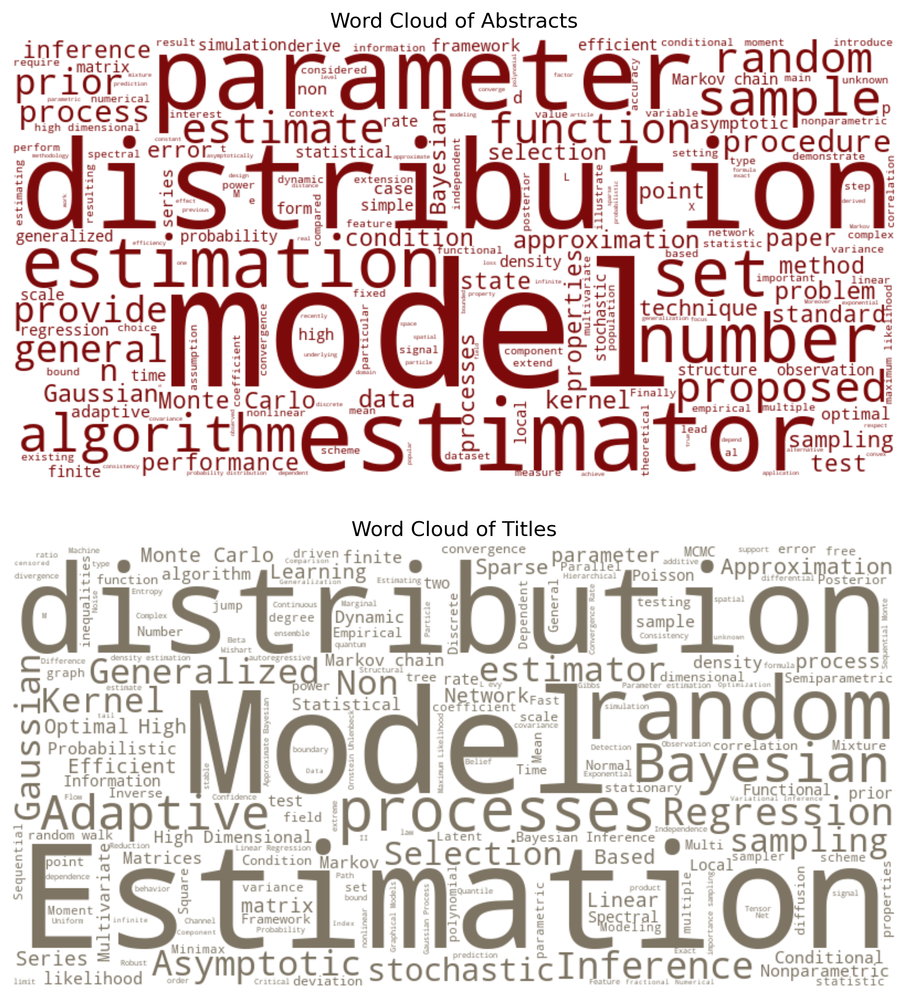

In [22]:
# Cluster 4: (2011-2015)
labtools.generate_wordclouds(clustered_df, cluster_number=4)

<center>
    <h6>
        <b>Figure 18. 
        </b> Word Cloud of Final Cluster 4 (2011-2015)
    </h6>
</center>

#### **Final Cluster 5 (2011-2015)**

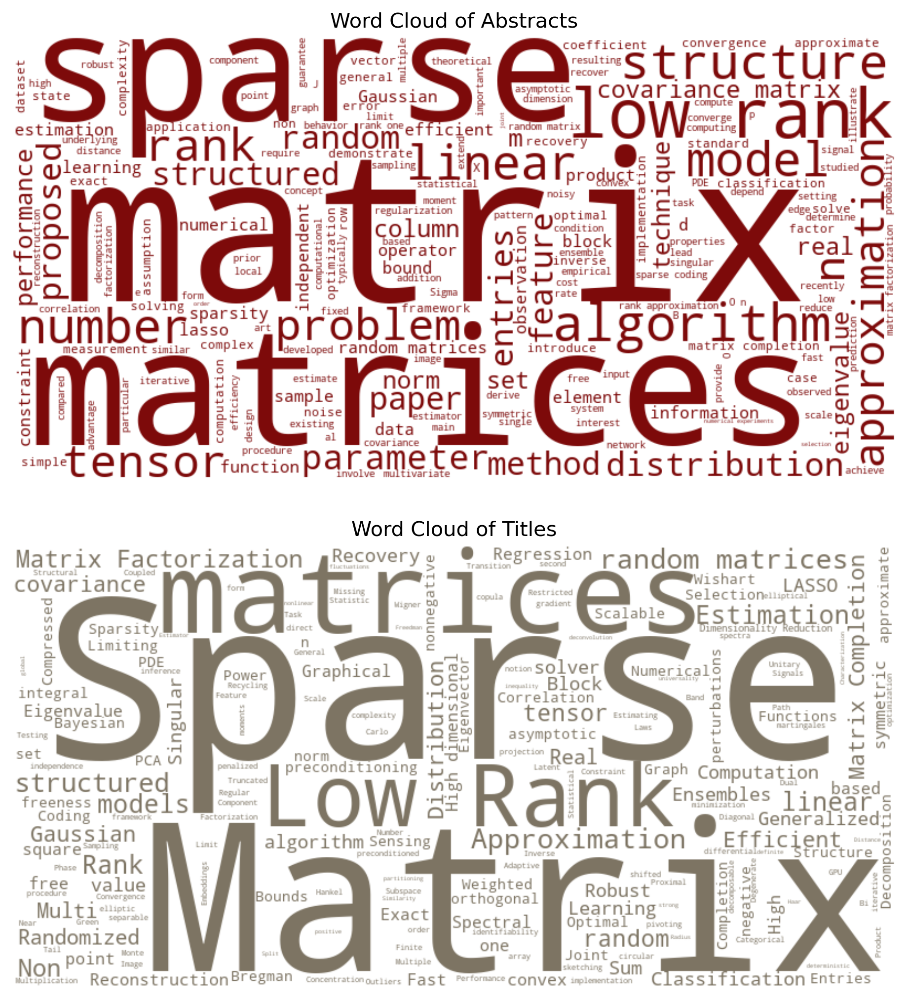

In [23]:
# Cluster 5: (2011-2015)
labtools.generate_wordclouds(clustered_df, cluster_number=5)

<center>
    <h6>
        <b>Figure 19. 
        </b> Word Cloud of Final Cluster 5 (2011-2015)
    </h6>
</center>

#### **Final Cluster 6 (2011-2015)**

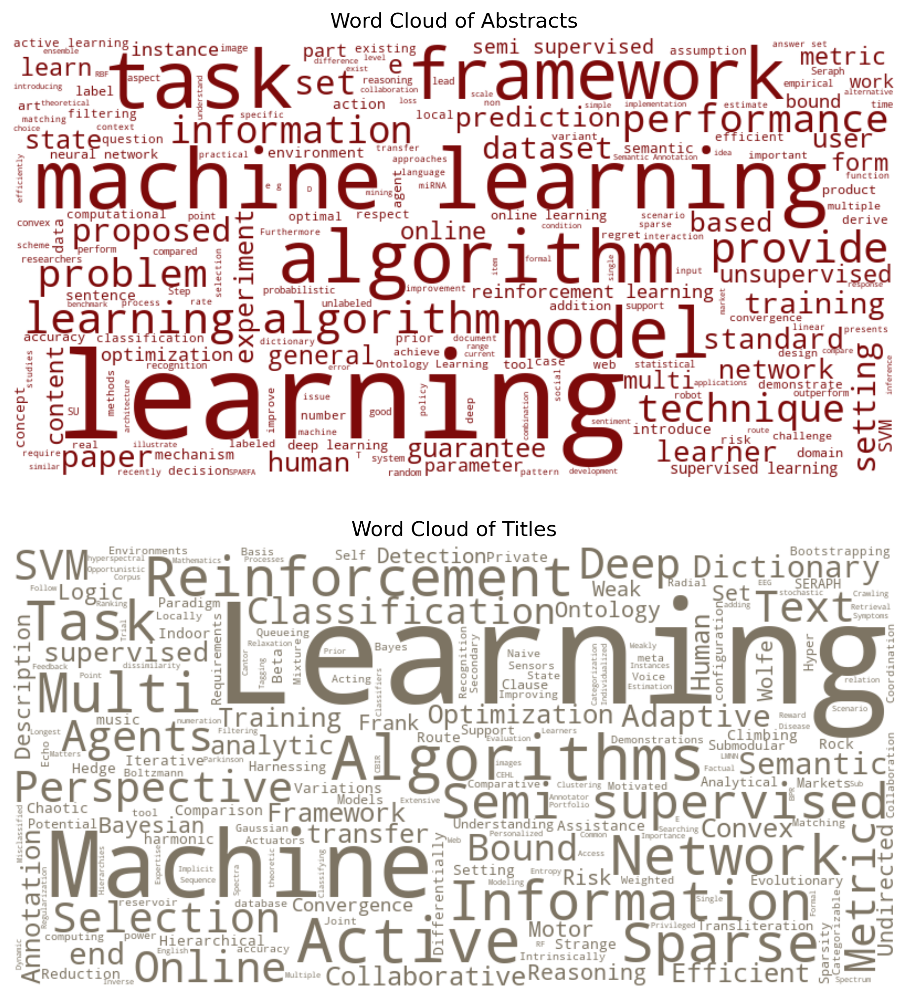

In [24]:
# Cluster 6: (2011-2015)
labtools.generate_wordclouds(clustered_df, cluster_number=6)

<center>
    <h6>
        <b>Figure 20. 
        </b> Word Cloud of Final Cluster 6 (2011-2015)
    </h6>
</center>

#### **Final Cluster 7 (2011-2015)**

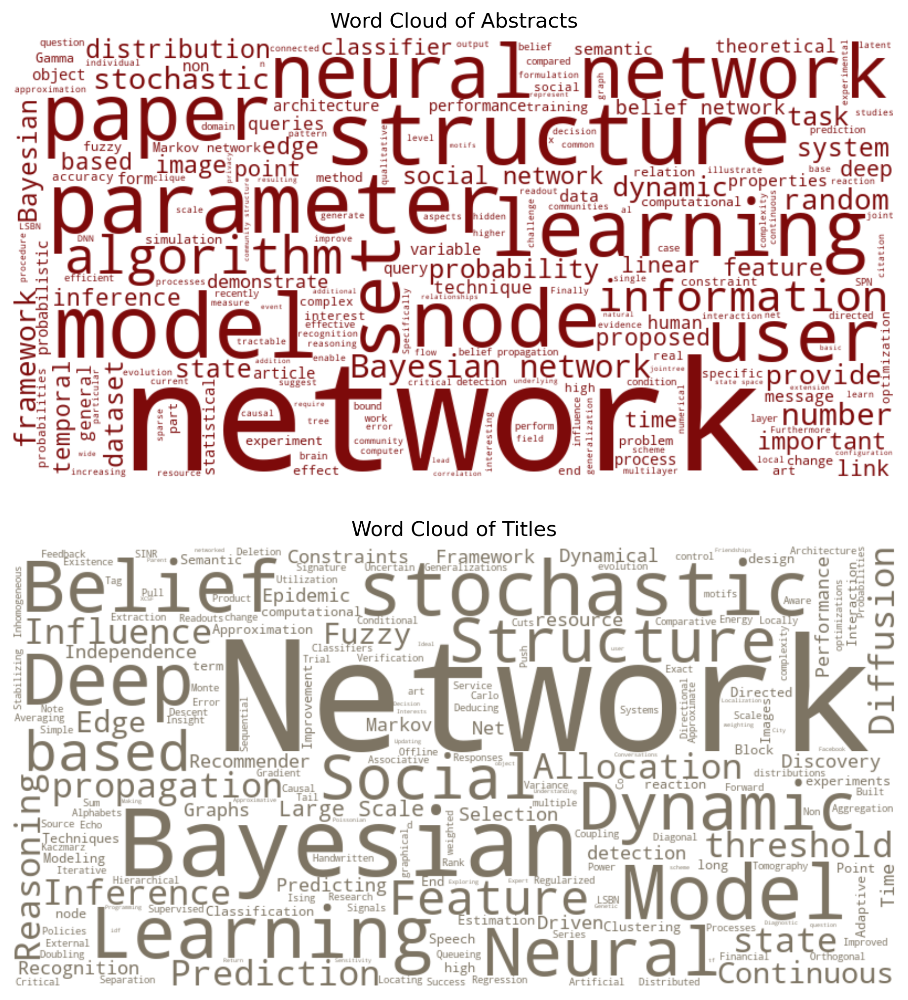

In [25]:
# Cluster 7: (2011-2015)
labtools.generate_wordclouds(clustered_df, cluster_number=7)

<center>
    <h6>
        <b>Figure 21. 
        </b> Word Cloud of Final Cluster 7 (2011-2015)
    </h6>
</center>

#### **Final Cluster 8 (2011-2015)**

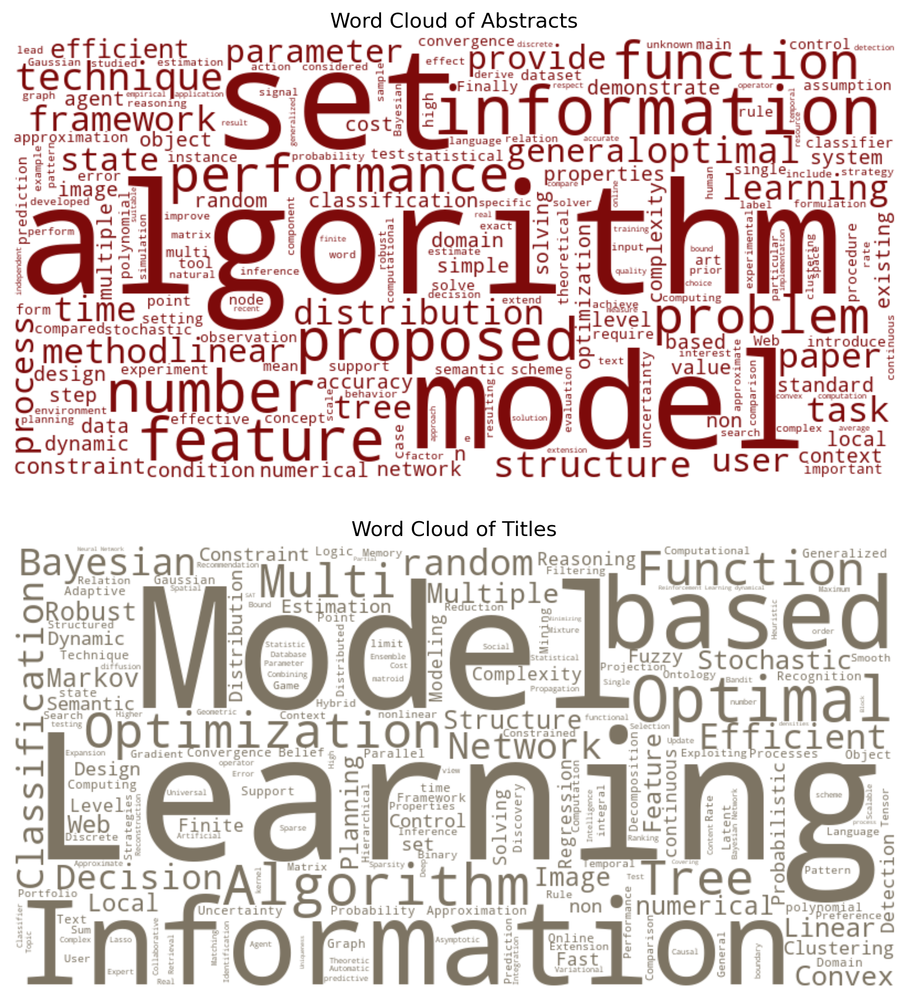

In [26]:
# Cluster 8: (2011-2015)
labtools.generate_wordclouds(clustered_df, cluster_number=8)

<center>
    <h6>
        <b>Figure 22. 
        </b> Word Cloud of Final Cluster 8 (2011-2015)
    </h6>
</center>

#### **Final Cluster 9 (2011-2015)**

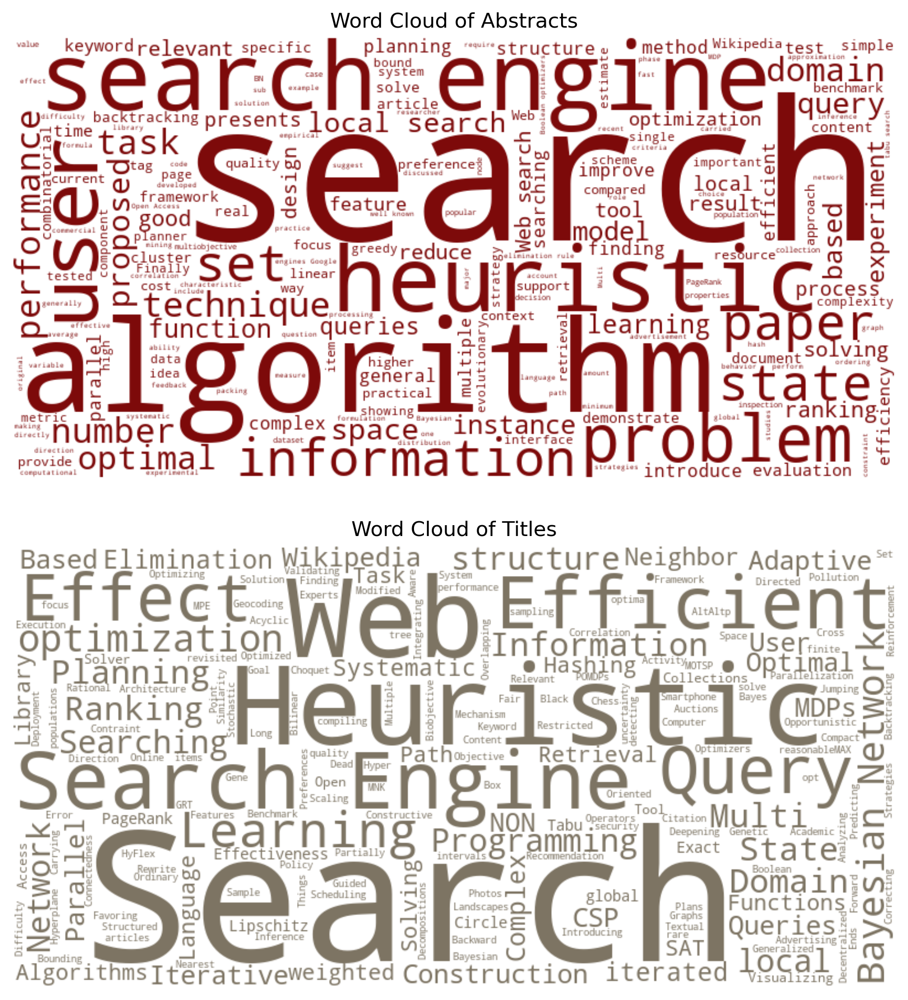

In [27]:
# Cluster 9: (2011-2015)
labtools.generate_wordclouds(clustered_df, cluster_number=9)

<center>
    <h6>
        <b>Figure 23. 
        </b> Word Cloud of Final Cluster 9 (2011-2015)
    </h6>
</center>

<div style="background-color:#711012; padding: 10px 0;">
    <center><h2 style="color: white; font-weight:bold">CLUSTER INTERPRETATION</h2></center>
</div>

#### **Cluster 1: Numerical Methods in Finite Element Analysis**
- **Abstract Keywords**: numerical, approximation, scheme, domain, convergence, finite element, discrete
- **Title Keywords**: finite element, numerical, approximation, scheme, nonlinear, convergence
- **Insights**:
  - This cluster likely centers on using numerical methods, especially finite element analysis, to approximate solutions for nonlinear problems. It also considers convergence and discretization schemes within a specific domain.

#### **Cluster 2: Stochastic Modeling and Random Processes with Graph Theory**
- **Abstract Keywords**: random, number, model, p, n, set, probability
- **Title Keywords**: random walk, stochastic, graph, processes
- **Insights**:
  - This cluster is somehow similar to the clusters related to statistics of the previous periods. However, graph theory is more emphasized during this period.

#### **Cluster 3: Stochastic Processes with Diffusion Modeling and Brownian Motion**
- **Abstract Keywords**: Stochastic. Processes, Brownian motion
- **Title Keywords**: diffusion, Brownian motion, convergence
- **Insights**:
  - This cluster still focuses on stochastic processes but emphasizes those related to diffusion phenomena and Brownian motion.

#### **Cluster 4: Statistical Modelling and Inference**
- **Abstract Keywords**: model, estimator, distribution, parameter, set, number
- **Title Keywords**: model, estimation, distribution, adaptive, Bayesian
- **Insights**:
  - This cluster has evolved from a focus on classical statistical modeling and parametric model estimation towards more flexible, distribution-based statistical learning techniques coupled with Bayesian inferential paradigms. It retains the core statistical modeling focus while adopting semi- and non-parametric models and Bayesian inference.

#### **Cluster 5: Sparse Matrix Analysis and Low-Rank Structures**
- **Abstract Keywords**: sparse, matrix, low rank, structure
- **Title Keywords**: sparse, matrix, matrices, low rank
- **Insights**:
  - Compared to the cluster on matrix analysis in 2006-2010, this cluster shifts away from eigenvalue-based methods and concentrates more on analyzing sparse matrices and exploring low-rank structures within them.

#### **Cluster 6: Machine Learning**
- **Abstract Keywords**: machine learning, task, algorithm, training, unsupervised, semi supervised
- **Title Keywords**: learning, reinforcement, information, machine, network, semi supervised, classification, SVM, supervised

#### **Cluster 7: Network Learning and Bayesian Dynamics**
- **Abstract Keywords**: network, neural, node, structure, paper, learning, user
- **Title Keywords**: network, neural, Bayesian, stochastic, social, dynamic, belief, deep, allocation
- **Insights**:
  - This cluster suggests a focus on network learning dynamics, Bayesian methods, and stochastic processes, particularly within social networks. Compared to the similar cluster in 2006-2010, this one appears to prioritize network learning dynamics and Bayesian approaches.

#### **Cluster 8: Information Modeling and Learning Optimization**
- **Abstract Keywords**: algorithm, model, set, information
- **Title Keywords**: model, learning, information, optimization

#### **Cluster 9: Web Search and Query Optimization**
- **Abstract Keywords**: search, engine, heuristic, algorithm, user, information, domain, query
- **Title Keywords**: web, search, engine, query
- **Insights**:
    - The abstract emphasizes search engine heuristics, user queries, and information domains, while the title highlights web search engines and user queries. Together, they suggest an exploration of algorithms and techniques for optimizing web search engines and improving query retrieval efficiency.

<div style="background-color:#711012; padding: 10px 0;">
    <center><h1 style="color: white; font-weight:bold">RESULTS AND DISCUSSION</h1></center>
</div>


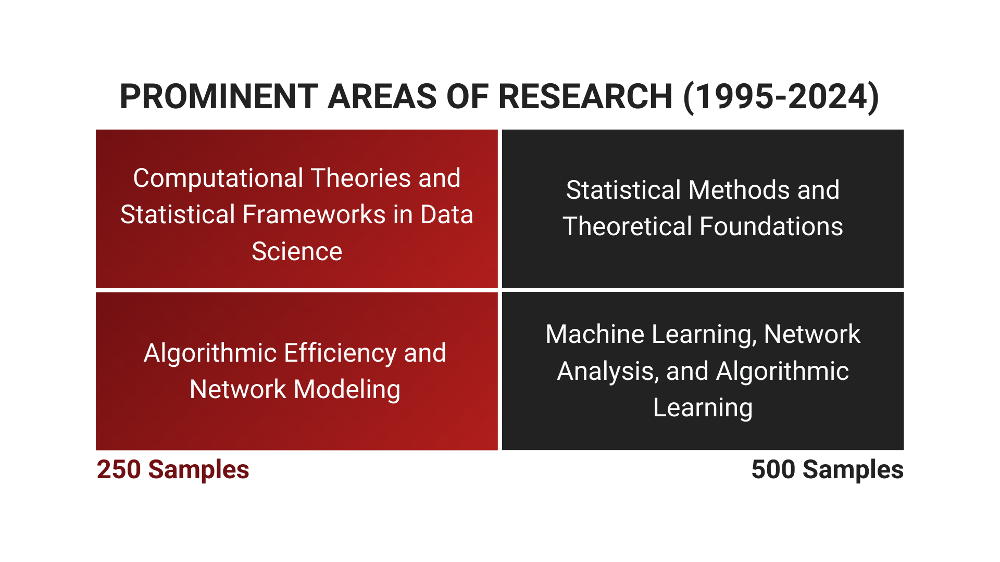

<center>
    <h6>
        <b>Figure 24. 
        </b> Timeline of Research Themes (1995-2024)
    </h6>
</center>

Using the *get-all-cluster-all* clustering technique across 250 and 500 samples, we get two closely related, if entirely similar, clusters. This thematic coherence falls in line with our predetermined selection criteria, which focused on specific categories such as mathematics, statistics, and computer science. Thus, it is not surprising that the formed clusters appear to be subsets of these categories.

However, there are certain nuances between using 250 and 500 samples that merited an additional sub-clustering for both cases. In the case involving 250 samples, while the distribution of data points was balanced across the two clusters, the presence of domain-specific and use-case-related terms (e.g., 'energy' and 'quantum') in the word cloud suggested the possibility of smaller, more specialized groups within the cluster, which could provide more granular insights into the underlying themes of research. 

In the case of 500 samples, the same pattern persists. However, unlike the scenario with 250 samples, the distribution of data points across the two clusters is unbalanced. Specifically, the cluster related to statistical methods and theoretical foundations contains more points. This asymmetry suggests the presence of potentially more detailed subgroups within this cluster, emphasizing the need for further exploration to reveal nuanced aspects of the research themes.

Below are the resulting subclusters, hereinafter referred to as final clusters:

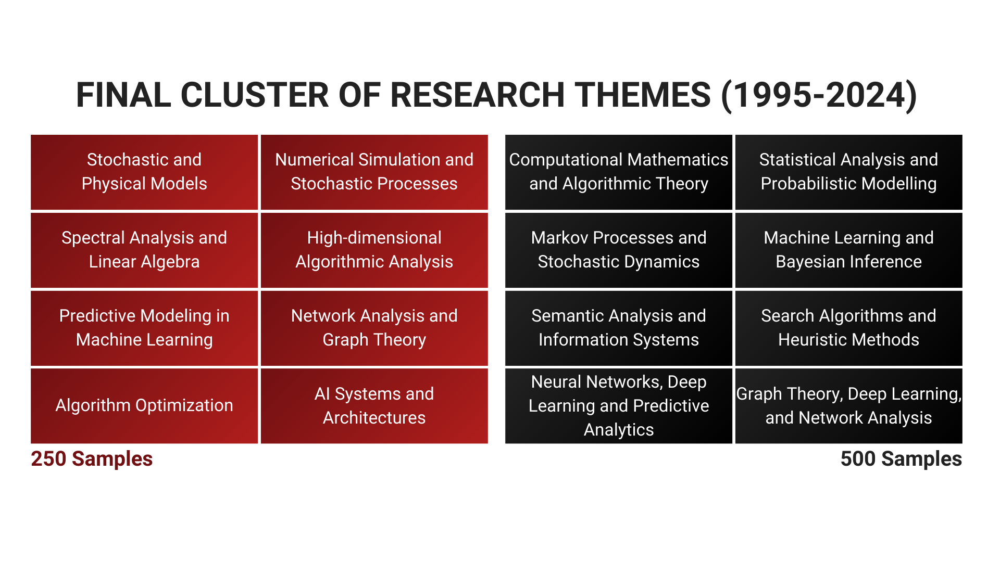
<center>
    <h6>
        <b>Figure 25. 
        </b> Final Cluster of Research Themes (1995-2024)
    </h6>
</center>

As previously noted, these clusters may not be consistently represented across all the years considered in this study; rather, they reflect the prevalent research themes over the past years. This is where segmenting our collection of research abstracts into five-year intervals proves valuable. By examining the evolution of research within narrower timeframes, we gain better visualization of the changes in areas of research interest.

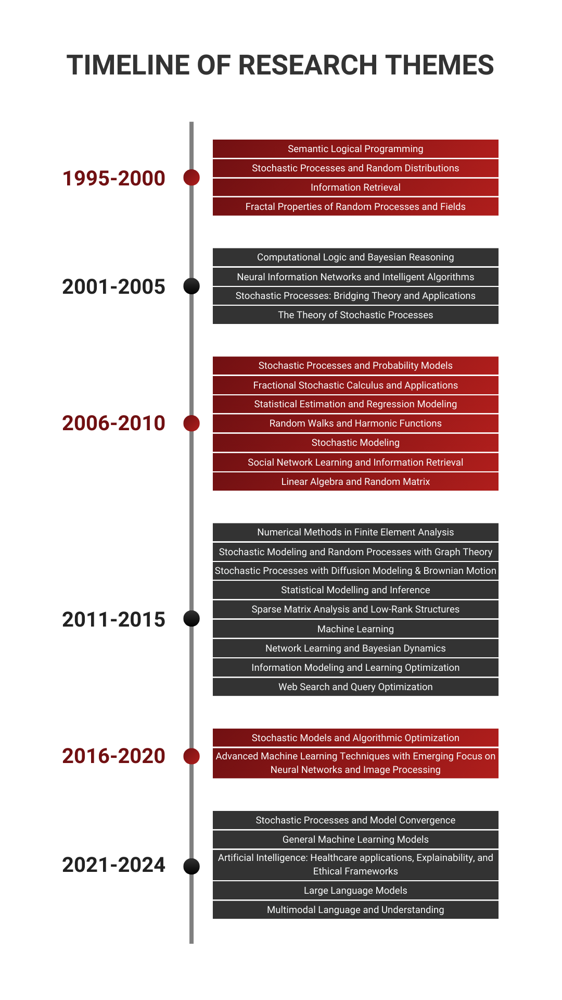

<center>
    <h6>
        <b>Figure 26. 
        </b> Timeline of Research Themes (1995-2024)
    </h6>
</center>

Figure 26 shows a summary of the research themes identified through agglomerative clustering from 1995 to 2024 with a five-year interval. Some of the salient topics deviate away from the popular areas of research determine by the *get-all-cluster-all* technique. For instance, the emergence of studies on artificial intelligence and large language models only surfaced 2021, therefore we can expect that there is not much published studies on it. Interestingly, the popularity of statistics as an area for research is consistent throughout 1995 to 2024. The only subtle deviation is the focus on either theory, applications, or a mix of both. These are more observable in the supplementary notebooks provided. One plausble reason for this is because statistics serves as a fundamental tool for data analysis, inference, and decision-making in disciplines ranging from social sciences to natural sciences and beyond. Its enduring relevance and adaptability to diverse research domains ensure a continuous demand for statistical methods and techniques.

However, if we compare the degree of evolution between the field of statistics and computer science, the latter easily dominates the former. The transformations of studies related to computer science and general programming encompassed diverse topics, including information retrieval, network analysis, machine learning, web search optimization, and many others. There may be several factors as to why this is the case. Firstly, the rapid advancements in technology and computing power over the past few decades have propelled computer science into new frontiers at an unprecedented pace. This has led to the emergence of novel subfields, such as artificial intelligence, machine learning, and data science. Secondly, the interdisciplinary nature of computer science may have contributed to its dynamic evolution, with intersections with fields like mathematics, engineering, and cognitive science. The practical applications of computer science in areas such as cybersecurity, software engineering, and information technology may have also fueled its growth and prominence in research agendas worldwide.

<div style="background-color:#711012; padding: 10px 0;">
    <center><h1 style="color: white; font-weight:bold">CONCLUSION AND RECOMMENDATIONS</h1></center>
</div>


All that we have done is to align the emerging themes of research publications and identify the gap in studies that could be further explored. This undertaking could benefit several stakeholders: 

- **Academic Researchers**: Scholars and researchers can gain insights into the evolving landscape of their respective fields, identify emerging research trends, and explore interdisciplinary collaborations. This information can inform the direction of future research projects and grant proposals.

- **Funding Agencies and Grantmakers**: Organizations responsible for funding research initiatives can use cluster analysis to identify priority areas for investment. Understanding the popularity and trajectory of research themes helps allocate resources effectively and support projects with the potential for significant impact.

- **Policy Makers and Government Agencies**: Policy makers rely on evidence-based research to inform decision-making processes and formulate policies that address societal challenges. Cluster analysis provides policymakers with a comprehensive overview of research themes, allowing them to identify areas where policy interventions may be needed and anticipate emerging issues.

- **Industry and Innovation Hubs**: Companies and innovation hubs can leverage cluster analysis to stay informed about developments in research and technology. Understanding trends in academic research helps businesses identify opportunities for collaboration, product development, and innovation in emerging fields.

- **Educational Institutions**: Universities and educational institutions can use cluster analysis to design curriculum, develop interdisciplinary programs, and recruit faculty members with expertise in trending research areas. This ensures that academic programs remain relevant and aligned with the evolving needs of industries and society.

Moving forward, to make this exploration even more data-driven, the following additions can be adopted:
- The similarity between clusters could be made more data-driven to accurately determine the difference between the salient themes of these two clusters
- If the computational resources allow, increase the number of categories included in the study to capture the broader landscape of research and innovation.
- One could explore using advanced natural language processing techniques to extact deeper insights from the abstracts. Network analysis could be done to visualize the interconnectedness between different research themes and identify influential nodes within the academic landscape.
- A shorter temporal analysis, such as yearly or quarterly, could also be done to capture more nuanced shifts in scholarly focus. 

<div style="background-color:#711012; padding: 10px 0;">
    <center><h1 style="color: white; font-weight:bold">REFERENCES</h1></center>
</div>


ArXiv. (2024). ArXiv Monthly Submission Rate Statistics. Retrieved from ArXiv statistics page.

Cornell University. (n.d.). About arXiv. Retrieved from ArXiv website.

Ginsparg, P. (2011). ArXiv at 20. Nature, 476(7359), 145-147.

Haque, A. U., & Ginsparg, P. (2009). Positional and temporal analysis of the ArXiv. Scientometrics, 79(3), 617-631.